# Mini-Project 
## ME-639 - Introduction to Robotics
### IIT Gandhinagar


### Question
Consider the 2R elbow manipulator discussed in class with two links of masses m1 & m2, lengths l1 & l2, respectively.

In [1]:
# Import Commands
import numpy as np
import matplotlib
matplotlib.rcParams['animation.embed_limit'] = 2**128
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
# Hard-Coding some of the variables
l1 = 1
l2 = 1
m1 = 1  # Mass of link 1
m2 = 1  # Mass of link 2
I1 = 1  # Moment of inertia of link 1
I2 = 1  # Moment of inertia of link 2
g = 9.81  # acceleration due to gravity (m/s^2)
x1,y1 = l2/2 + l1/2,0

In [3]:
# Defining the important functions

def cartesian(q1, q2): # Forward Kinematics
    x = l1 * np.cos(q1) + l2 * np.cos(q2)
    y = l1 * np.sin(q1) + l2 * np.sin(q2)
    return x, y

def forward_kin_vel(q1,q2,q1_dot,q2_dot):
    x_dot = -l1*np.sin(q1)*q1_dot - l2*np.sin(q2)*q2_dot
    y_dot = l1*np.cos(q1)*q1_dot + l2*np.cos(q2)*q2_dot
    return x_dot,y_dot 

def forward_kin_acc(q1,q2,q1_dot,q2_dot,q1_ddot,q2_ddot):
    x_ddot = -l1*np.sin(q1)*q1_ddot -l1*np.cos(q1)*q1_dot**2 - l2*np.sin(q2)*q2_ddot - l2*np.cos(q2)*q2_dot**2
    y_ddot = l1*np.cos(q1)*q1_ddot - l1*np.sin(q1)*q1_dot**2 + l2*np.cos(q2)*q2_ddot - l2*np.sin(q2)*q2_dot**2
    return x_ddot,y_ddot 

def inverse_kin_acc(q1,q2,q1_dot,q2_dot,x_ddot,y_ddot):
    A = x_ddot + l1*np.cos(q1)*q1_dot**2  + l2*np.cos(q2)*q2_dot**2
    B = y_ddot + l1*np.sin(q1)*q1_dot**2  + l2*np.sin(q2)*q2_dot**2
    M = np.array([[-l1*np.sin(q1), - l2*np.sin(q2)],[l1*np.cos(q1), l2*np.cos(q2)]])
    q_ddot =  np.dot(np.linalg.inv(M),np.array([A,B]))
    print(q_ddot)
    return q_ddot

def initial_pos(x,y):
    theta = np.arccos((x**2 + y**2 - l1**2 - l2**2)/(2*l1*l2))
    q1=np.arctan2(y,x)-np.arctan2((l2*np.sin(theta)),(l1+l2*np.cos(theta)))
    return q1,q1+theta


def end_effector_velocity(q1, q2, q1_dot, q2_dot):
    J = np.array([[-l1 * np.sin(q1), -l2 * np.sin(q2)],
                  [l1 * np.cos(q1), l2 * np.cos(q2)]])
    x_dot, y_dot = np.dot(J, np.array([q1_dot, q2_dot]))
    return x_dot, y_dot

def inverse_kinematics(q1, q2, x_dot, y_dot):
    J = np.array([[-l1 * np.sin(q1), -l2 * np.sin(q2)],
                  [l1 * np.cos(q1), l2 * np.cos(q2)]])
    J_inv = np.linalg.inv(J)
    q1_dot, q2_dot = np.dot(J_inv, np.array([x_dot, y_dot]))
    return q1_dot, q2_dot

def dynamic_Torque(q1,q2,q1_dot,q2_dot,q1_ddot,q2_ddot):
    T1 = (m1*l1**2*q1_ddot)/3  +  (m2*l1**2*q1_ddot) + (m2*l1*l2*q2_ddot*np.cos(q2-q1))/2 - m2*l1*l2*q2_dot**2*np.sin(q2-q1)/2 + m2*g*l1*np.cos(q1)/2 + m2*g*l1*np.cos(q1)
    T2 = m2*l2**2*q2_ddot/3 + m2*l1*l2*q1_ddot*np.cos(q2-q1)/2 + m2*l1*l2*q1_dot**2*np.sin(q2-q1)/2 + m2*g*l2*np.sin(q2)/2
    #T1 = (m1*l1**2*q1_ddot)/3  +  (m2*l1**2*q1_ddot) + (m2*l1*l2*q2_ddot*np.cos(q2-q1))/2 - m2*l1*l2*q2_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l1*np.cos(q1)/2 + m2*g*l1*np.cos(q1)
    #T2 = m2*l2**2*q1_ddot/3 + m2*l2**2*q2_ddot/4 + m2*l1*l2*q1_ddot*np.cos(q2-q1)/2 - m2*l1*l2*q1_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l2*np.sin(q2)/2
    return np.array([T1,T2])

def spring_F(k,q1,q2,x0,y0):
    Fx = -k*(l1*np.cos(q1) + l2*np.cos(q2) - x0)
    Fy = -k*(l1*np.sin(q1) + l2*np.sin(q2) - y0)
    return np.array([Fx,Fy])

def friction(mu,q1,q2,q1_dot,q2_dot):
    x_dot = -11*np.sin(q1)*q1_dot -l2*np.sin(q2)*q2_dot
    y_dot = 11*np.cos(q1)*q1_dot + l2*np.cos(q2)*q2_dot
    return np.array([mu*x_dot,mu*y_dot])

def static_Torque(q1,q2,Fx,Fy):
    M = np.array([[-l1*np.sin(q1),l1*np.cos(q1)],[-l2*np.sin(q2),l2*np.cos(q2)]])
    return np.dot(M,np.array([Fx,Fy]))

# Equations of motion
def forward_dynamics(q1, q2, q1_dot, q2_dot, tau1, tau2):
    G1 = tau1 + m2*l1*l2*q2_dot**2*np.sin(q2-q1)/2 - m2*g*l1*np.cos(q1)/2 - m2*g*l1*np.cos(q1)  #Hriday
    G2 = tau2 + m2*l1*l2*q1_dot**2*np.sin(q2-q1)/2 - m2*g*l2*np.sin(q2)/2                       #Hriday
    #G1 = tau1 + m2*l1*l2*q2_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 - m2*g*l1*np.cos(q1)/2 - m2*g*l1*np.cos(q1)  
    #G2 = tau2 + m2*l1*l2*q1_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 - m2*g*l2*np.sin(q2)/2
    
    #M =  np.array([[(m1*l1**2)/3  +  (m2*l1**2) , (m2*l1*l2*np.cos(q2-q1))/2] , [ m2*l1*l2*np.cos(q2-q1)/2 , (m2*l2**2)/3 ]])
    M =  np.array([[(m1*l1**2)/3  +  (m2*l1**2) , (m2*l1*l2*np.cos(q2-q1))/2] , [ m2*l1*l2*np.cos(q2-q1)/2 , (m2*l2**2)/3 ]])
    
    q_ddot = np.dot(np.linalg.inv(M),np.array([G1,G2])) 
    return q_ddot

def torque_cals(q1,q2,Nx,Ny):
    tau_1 = -l1*np.sin(q1)*Nx - l1*np.cos(q1)*Ny
    tau_2 = -l2*np.sin(q2)*Nx + l2*np.cos(q2)*Ny
    return tau_1,tau_2

def spring_taus(q1,q2):
    k=1
    tau_1s=k(l1*np.sin(q1)+l2*np.sin(q2))*l1*np.cos(q2)-k(l1*np.cos(q1+l2*np.cos(q2))*l1*np.sin(q2))
    tau_2s=k(l1*np.sin(q1)+l2*np.sin(q2))*l2*np.cos(q2)-k(l1*np.cos(q1+l2*np.cos(q2))*l2*np.sin(q2))
    return tau_1s, tau_2s


### Task 1
    Write a Python simulation with visualization that implements a trajectory following controller that makes the robot follow an arbitrary end-tip trajectory.
    a. Also, analyze how different the results are when dynamics are included versus not included (try both low-speed and high-speed trajectories).

##### Without Dynamics (Low Speed Trajectory)

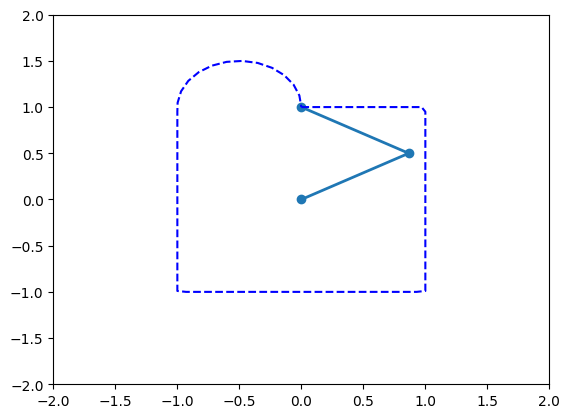

In [4]:
dt = 0.1
tF = 32
def path(t):
    if t<4:
        return t / 4, 1
    if t<12:
        return 1, 2 - t/4
    if t < 20:
        return 4-t/4,-1
    if t< 28:
        return -1,t/4 - 6
    else:
        return -1/2 - np.cos((t-28)*np.pi/4)/2 , 1 + np.sin((t-28)*np.pi/4)/2
# Animation function
def animate(t):
    x, y = path(t)
    q1, q2 = initial_pos(x, y)
    robotx = [0, l1 * np.cos(q1), l1 * np.cos(q1) + l2 * np.cos(q2)]
    roboty = [0, l1 * np.sin(q1), l1 * np.sin(q1) + l2 * np.sin(q2)]

    line_robot.set_data(robotx, roboty)

    px = [path(t_)[0] for t_ in np.linspace(0, t, 100)]
    py = [path(t_)[1] for t_ in np.linspace(0, t, 100)]
    line_path.set_data(px, py)

    # Calculate end-effector velocity
    x_dot, y_dot = np.gradient(px)[-1] / dt, np.gradient(py)[-1] / dt

    # Use inverse kinematics to solve the differential equation for joint velocities
    q1_dot, q2_dot = inverse_kinematics(q1, q2, x_dot, y_dot)

    # Update joint angles
    q1 += q1_dot * dt
    q2 += q2_dot * dt

    return line_robot, line_path

fig, ax = plt.subplots()
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2])
line_robot, = ax.plot([], [], 'o-', lw=2)
line_path, = ax.plot([], [], 'b--')

# Create the animation
animation = FuncAnimation(fig, animate, frames=np.linspace(0, tF, int(tF/dt)),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### Without Dynamics (High Speed Trajectory)

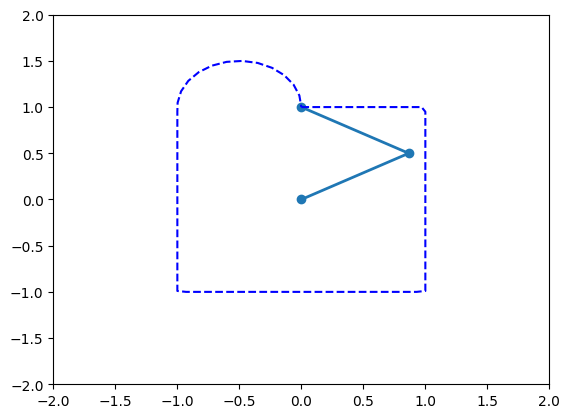

In [5]:
dt = 0.1
tF = 2
def path(t):
    if t<0.25:
        return t / 0.25, 1
    if t<0.75:
        return 1, 2 - t/0.25
    if t < 1.25:
        return 4-t/0.25,-1
    if t< 1.75:
        return -1,t/0.25 - 6
    else:
        return -1/2 - np.cos((t-1.75)*np.pi/0.25)/2 , 1 + np.sin((t-1.75)*np.pi/0.25)/2

# Animation function
def animate(t):
    x, y = path(t)
    q1, q2 = initial_pos(x, y)
    robotx = [0, l1 * np.cos(q1), l1 * np.cos(q1) + l2 * np.cos(q2)]
    roboty = [0, l1 * np.sin(q1), l1 * np.sin(q1) + l2 * np.sin(q2)]

    line_robot.set_data(robotx, roboty)

    px = [path(t_)[0] for t_ in np.linspace(0, t, 100)]
    py = [path(t_)[1] for t_ in np.linspace(0, t, 100)]
    line_path.set_data(px, py)

    # Calculate end-effector velocity
    x_dot, y_dot = np.gradient(px)[-1] / dt, np.gradient(py)[-1] / dt

    # Use inverse kinematics to solve the differential equation for joint velocities
    q1_dot, q2_dot = inverse_kinematics(q1, q2, x_dot, y_dot)

    # Update joint angles
    q1 += q1_dot * dt
    q2 += q2_dot * dt

    return line_robot, line_path

fig, ax = plt.subplots()
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2])
line_robot, = ax.plot([], [], 'o-', lw=2)
line_path, = ax.plot([], [], 'b--')

# Create the animation
animation = FuncAnimation(fig, animate, frames=np.linspace(0, tF, int(tF/dt)),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### With Dynamics Involved (Low Speed Trajectory)

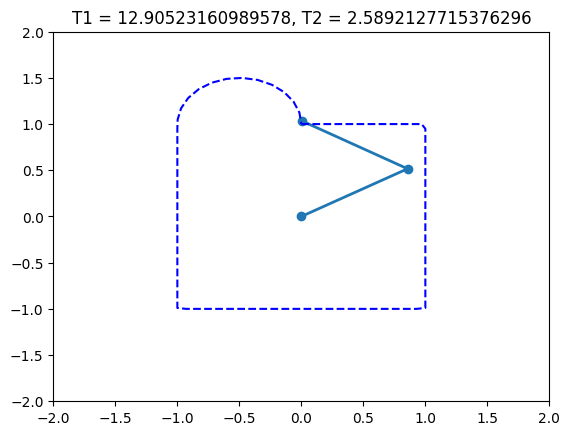

In [6]:
dt = 0.1
tF = 32
def path(t):
    if t<4:
        return t / 4, 1
    if t<12:
        return 1, 2 - t/4
    if t < 20:
        return 4-t/4,-1
    if t< 28:
        return -1,t/4 - 6
    else:
        return -1/2 - np.cos((t-28)*np.pi/4)/2 , 1 + np.sin((t-28)*np.pi/4)/2


# Create a figure and axis for plotting
fig, ax = plt.subplots()
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2])
line_robot, = ax.plot([], [], 'o-', lw=2)
line_path, = ax.plot([], [], 'b--')
x,y = path(0)
q1, q2 = initial_pos(x, y)

# Animation function
def animate(t):
    global q1,q2,q1_dot,q2_dot,x,y,x0,y0
    x0, y0 = x,y
    x,y = path(t)
    x_dot,y_dot = (x-x0)/dt,(y-y0)/dt

    robotx = [0, l1 * np.cos(q1), l1 * np.cos(q1) + l2 * np.cos(q2)]
    roboty = [0, l1 * np.sin(q1), l1 * np.sin(q1) + l2 * np.sin(q2)]

    line_robot.set_data(robotx, roboty)

    px = [path(t_)[0] for t_ in np.linspace(0, t, 100)]
    py = [path(t_)[1] for t_ in np.linspace(0, t, 100)]
    line_path.set_data(px, py)

    # Calculate end-effector velocity
    #x_dot, y_dot = np.gradient(px)[-1] / dt, np.gradient(py)[-1] / dt

    # Use inverse kinematics to solve the differential equation for joint velocities
    try:
        q1_dot_old,q2_dot_old = q1_dot,q2_dot
    except:
        pass
    q1_dot, q2_dot = inverse_kinematics(q1, q2, x_dot, y_dot)
    try:
        q1_ddot, q2_ddot = (q1_dot-q1_dot_old)/dt , (q2_dot-q2_dot_old)/dt
        T1,T2 = dynamic_Torque(q1,q2,q1_dot,q2_dot,q1_ddot,q2_ddot)
        #T1 = (m1*l1**2*q1_ddot)/3  +  (m2*l1**2*q1_ddot) + (m2*l1*l2*q2_ddot*np.cos(q2-q1))/2 - m2*l1*l2*q2_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l1*np.cos(q1)/2 + m2*g*l1*np.cos(q1)
        #T2 = m2*l2**2*q1_ddot/3 + m2*l2**2*q2_ddot/4 + m2*l1*l2*q1_ddot*np.cos(q2-q1)/2 - m2*l1*l2*q1_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l2*np.sin(q2)/2
        ax.set_title(f"T1 = {T1}, T2 = {T2}")
    except:
        pass
    # Update joint angles
    q1 += q1_dot * dt
    q2 += q2_dot * dt
    return line_robot, line_path

# Create the animation
animation = FuncAnimation(fig, animate, frames=np.linspace(0, tF, int(tF/dt)),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### With Dynamics Involved (High Speed Trajectory)

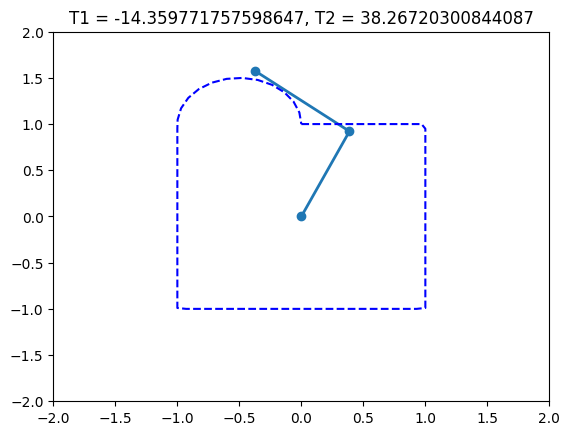

In [7]:
dt = 0.1
tF = 2
def path(t):
    if t<0.25:
        return t / 0.25, 1
    if t<0.75:
        return 1, 2 - t/0.25
    if t < 1.25:
        return 4-t/0.25,-1
    if t< 1.75:
        return -1,t/0.25 - 6
    else:
        return -1/2 - np.cos((t-1.75)*np.pi/0.25)/2 , 1 + np.sin((t-1.75)*np.pi/0.25)/2



# Create a figure and axis for plotting
fig, ax = plt.subplots()
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2])
line_robot, = ax.plot([], [], 'o-', lw=2)
line_path, = ax.plot([], [], 'b--')
x,y = path(0)
q1, q2 = initial_pos(x, y)

# Animation function
def animate(t):
    global q1,q2,q1_dot,q2_dot,x,y,x0,y0
    x0, y0 = x,y
    x,y = path(t)
    x_dot,y_dot = (x-x0)/dt,(y-y0)/dt

    robotx = [0, l1 * np.cos(q1), l1 * np.cos(q1) + l2 * np.cos(q2)]
    roboty = [0, l1 * np.sin(q1), l1 * np.sin(q1) + l2 * np.sin(q2)]

    line_robot.set_data(robotx, roboty)

    px = [path(t_)[0] for t_ in np.linspace(0, t, 100)]
    py = [path(t_)[1] for t_ in np.linspace(0, t, 100)]
    line_path.set_data(px, py)

    # Calculate end-effector velocity
    #x_dot, y_dot = np.gradient(px)[-1] / dt, np.gradient(py)[-1] / dt

    # Use inverse kinematics to solve the differential equation for joint velocities
    try:
        q1_dot_old,q2_dot_old = q1_dot,q2_dot
    except:
        pass
    q1_dot, q2_dot = inverse_kinematics(q1, q2, x_dot, y_dot)
    try:
        q1_ddot, q2_ddot = (q1_dot-q1_dot_old)/dt , (q2_dot-q2_dot_old)/dt
        T1,T2 = dynamic_Torque(q1,q2,q1_dot,q2_dot,q1_ddot,q2_ddot)
        #T1 = (m1*l1**2*q1_ddot)/3  +  (m2*l1**2*q1_ddot) + (m2*l1*l2*q2_ddot*np.cos(q2-q1))/2 - m2*l1*l2*q2_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l1*np.cos(q1)/2 + m2*g*l1*np.cos(q1)
        #T2 = m2*l2**2*q1_ddot/3 + m2*l2**2*q2_ddot/4 + m2*l1*l2*q1_ddot*np.cos(q2-q1)/2 - m2*l1*l2*q1_dot*(q2_dot-q1_dot)*np.sin(q2-q1)/2 + m2*g*l2*np.sin(q2)/2
        ax.set_title(f"T1 = {T1}, T2 = {T2}")
    except:
        pass
    # Update joint angles
    q1 += q1_dot * dt
    q2 += q2_dot * dt
    return line_robot, line_path

# Create the animation
animation = FuncAnimation(fig, animate, frames=np.linspace(0, tF, int(tF/dt)),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### Task 2 
    Assume a wall location and orientation, develop and implement using a
    Python simulation and visualization the task of the robot reaching the wall
    and then applying a prespecified force in the normal direction of the wall.

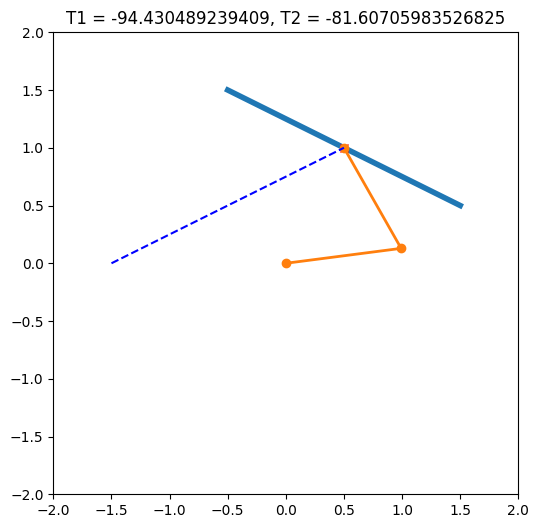

In [8]:
x0=-1.5; y0= 0
x1=0.5; y1=1

# Equation of the Wall
wx1, wx2, wy1, wy2 = 1.5, -0.5, 0.5, 1.5
theta_wall=np.arctan2(wy2-wy1,wx2-wx1)

dt = 0.1
tF = 4
def path(t):
    return (x1-x0)*t/tF + x0, (y1-y0)*t/tF + y0 

Force_wall=100


# Animation function
def animate(t):
    x, y = path(t)
    q1, q2 = initial_pos(x, y)
    robotx = [0, l1 * np.cos(q1), l1 * np.cos(q1) + l2 * np.cos(q2)]
    roboty = [0, l1 * np.sin(q1), l1 * np.sin(q1) + l2 * np.sin(q2)]

    line_robot.set_data(robotx, roboty)

    px = [path(t_)[0] for t_ in np.linspace(0, t, 100)]
    py = [path(t_)[1] for t_ in np.linspace(0, t, 100)]
    line_path.set_data(px, py)

    # Calculate end-effector velocity
    x_dot, y_dot = np.gradient(px)[-1] / dt, np.gradient(py)[-1] / dt

    # Use inverse kinematics to solve the differential equation for joint velocities
    q1_dot, q2_dot = inverse_kinematics(q1, q2, x_dot, y_dot)

    # Update joint angles
    q1 += q1_dot * dt
    q2 += q2_dot * dt
    T1,T2 = 0,0
    if t == tF:
        T1,T2=torque_cals(q1,q2,Force_wall*np.sin(theta_wall),Force_wall*np.cos(theta_wall)*(-1))
        ax.set_title(f"T1 = {T1}, T2 = {T2}")

    return line_robot, line_path

fig, ax = plt.subplots(figsize=(6, 6))
ax.set_xlim([-2, 2])
ax.set_ylim([-2, 2])
ax.plot([wx1,wx2],[wy1,wy2],lw=4)
ax.plot(0.5,1,'rx')
line_robot, = ax.plot([], [], 'o-', lw=2)
line_path, = ax.plot([], [], 'b--')

# Create the animation
animation = FuncAnimation(fig, animate, frames=np.linspace(0, tF, int(tF/dt)),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### Task 3
    Develop and implement a control scheme that makes the robot end-tip act
    like a virtual spring centered at the mean position of xo and yo.
    Demonstrate the performance of this method by initializing from a few
    different points away from xo and yo.

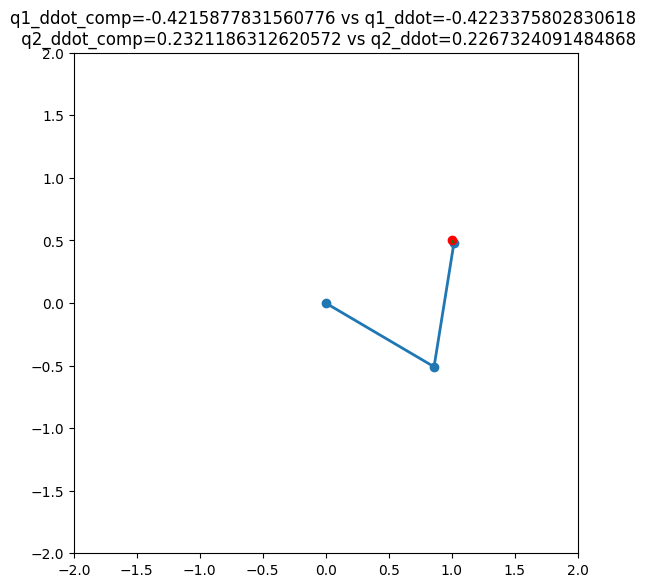

In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Manipulator parameters
l1 = 1.0
l2 = 1.0
m1 = 1.0
m2 = 1.0
g = 9.81
# Defining the important functions

# ... (All the functions you provided)

# Simulation parameters
dt = 0.1
tF = 30

# Initial conditions
x_initial = 0.5
y_initial = 1.0

# Mean position
x_mean = 1.0
y_mean = 0.5

# Initial joint angles
q1, q2 = initial_pos(x_initial, y_initial)
q1_dot = 0.0
q2_dot = 0.0
q1_dot_old = 0
q2_dot_old = 0
x_dot = 0
y_dot = 0
# Lists to store simulation data
x_traj = []
y_traj = []

# Create a figure and axis for plotting
fig, ax = plt.subplots(figsize=(6.5, 6.5))
ax.set_xlim([-l1-l2, l1+l2])
ax.set_ylim([-l1-l2, l1+l2])
line_arm, = ax.plot([], [], 'o-', lw=2)
line_mean, = ax.plot([], [], 'ro')
line_spring, = ax.plot([], [], 'g--')

# Animation function
def animate(i):
    global x_dot,y_dot,q1,q2,q1_dot,q2_dot
    k = 10
    mu = 0.2
    Nx,Ny = spring_F(k,q1,q2,x_mean,y_mean) - mu*np.array([x_dot,y_dot])
    x_dot += Nx*dt
    y_dot += Ny*dt
    q1_dot_olde,q2_dot_old = q1_dot,q2_dot 
    q1_dot,q2_dot = inverse_kinematics(q1,q2,x_dot,y_dot)
    q1_ddot = (q1_dot-q1_dot_old)/dt
    q2_ddot = (q2_dot-q2_dot_old)/dt
    T1,T2 = dynamic_Torque(q1,q2,q1_dot,q2_dot,q1_ddot,q2_ddot)
    q1_ddot_comp,q2_ddot_comp = forward_dynamics(q1, q2, q1_dot, q2_dot, T1, T2)
    ax.set_title(f"q1_ddot_comp={q1_ddot_comp} vs q1_ddot={q1_ddot} \n q2_ddot_comp={q2_ddot_comp} vs q2_ddot={q2_ddot}")
    q1 += q1_dot * dt
    q2 += q2_dot * dt
    x, y = cartesian(q1, q2)
    
    # Arm points
    arm_x = [0, l1 * np.cos(q1), x]
    arm_y = [0, l1 * np.sin(q1), y]
    
    # Spring points
    spring_x = [x_mean, x]
    spring_y = [y_mean, y]
    
    # Update plot data
    line_arm.set_data(arm_x, arm_y)
    line_mean.set_data([x_mean], [y_mean])
    line_spring.set_data(spring_x, spring_y)
    
    return line_arm, line_mean, line_spring

# Create the animation
animation = FuncAnimation(fig, animate, frames=int(tF/dt),
                          interval=dt*1000, blit=True)

# Display the animation in the Jupyter notebook
HTML(animation.to_jshtml())

##### Task 4
    If both joint angles can only sweep between 35 degrees and 145 degrees,
    determine and plot the workspace for the robot.

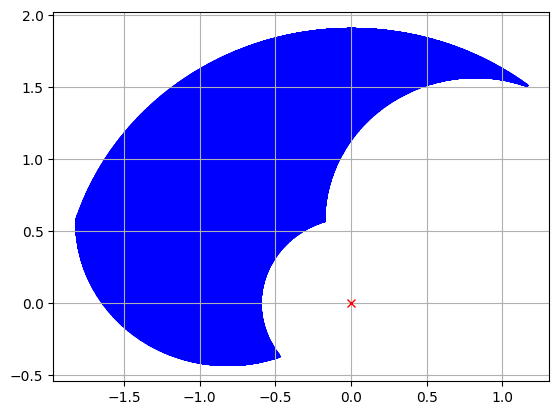

In [10]:
# Hard-Coding some of the variables
l1 = 1
l2 = 1
reso1 = 1000
reso2 = 1000
theta_1_l=35
theta_2_l=35
theta_1_u=145
theta_2_u=145

q1 = np.linspace(np.radians(theta_1_l),np.radians(theta_1_u),reso1,endpoint=True)

workspace = np.zeros((2,reso1*reso2))

k = 0
for i in q1:
    q2 = np.linspace(i+np.radians(theta_2_l),i+np.radians(theta_2_u),reso2,endpoint=True)
    for j in q2:
        workspace[:,k] = cartesian(i,j)
        k += 1
plt.plot(0,0,'rx')
plt.scatter(workspace[0,:],workspace[1,:],color='b',marker='x',s=1)
plt.grid()
plt.show()